In [ ]:
!pip install diffusers
!pip install transformers
!pip install peft
!pip install PIL

In [ ]:
import os
from PIL import Image

import torch
from diffusers import StableDiffusionInpaintPipeline
from transformers import AutoTokenizer
from peft import PeftModel, LoraConfig

In [ ]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

In [ ]:
pipe = StableDiffusionInpaintPipeline.from_pretrained("runwayml/stable-diffusion-inpainting").to(device)

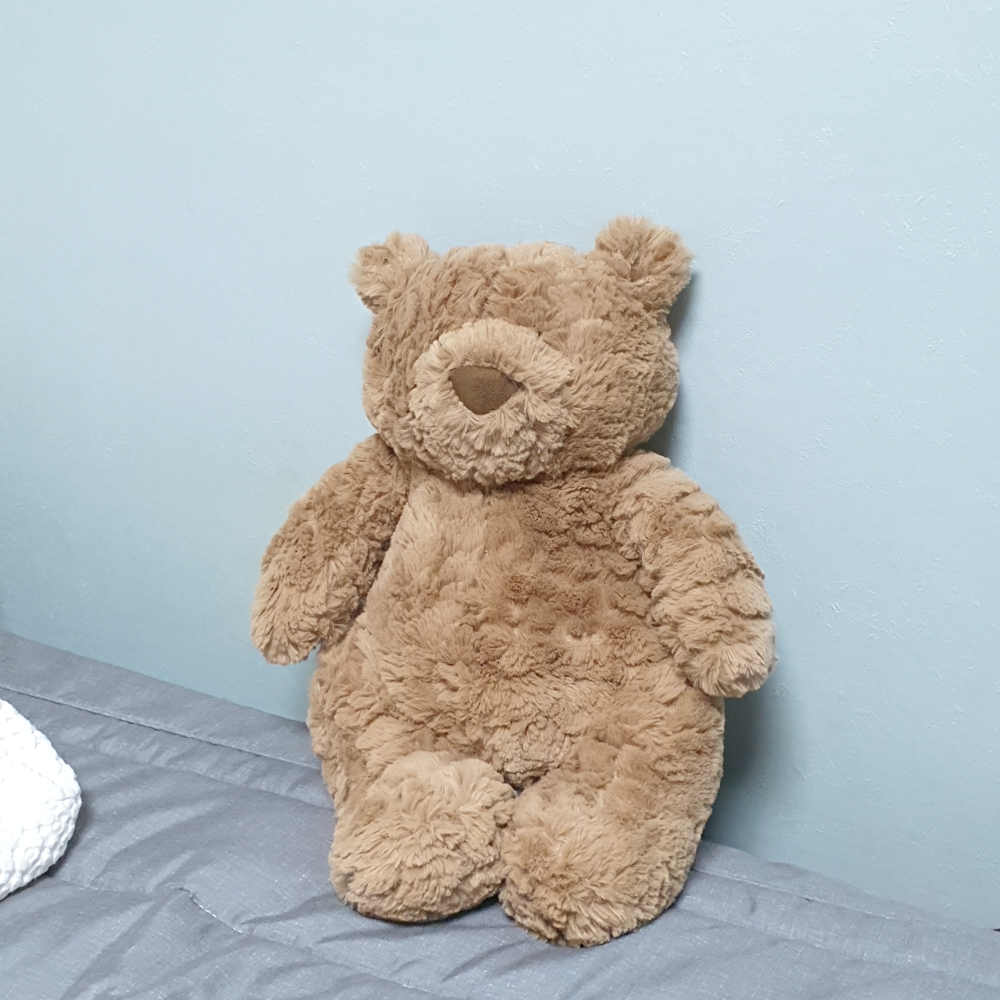

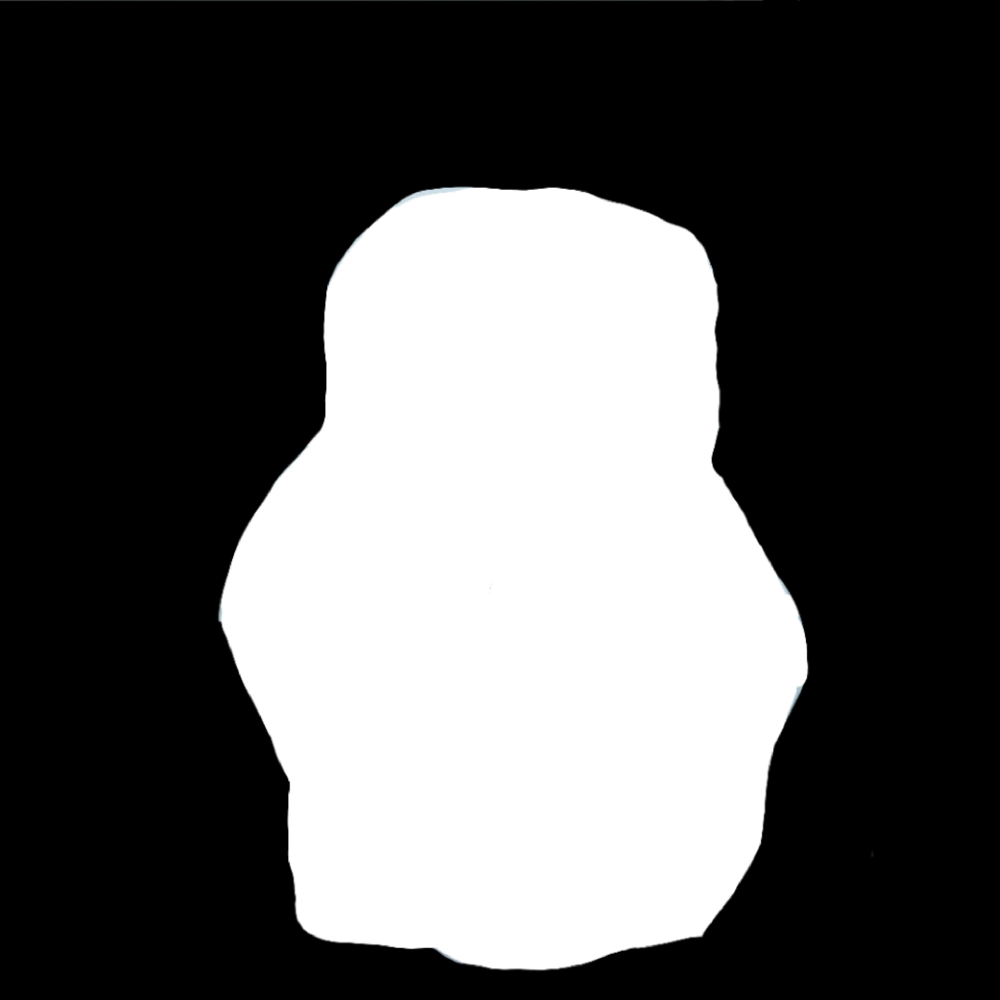

In [11]:
prompt = "A photo of sks panda"
base_image = Image.open("test/base.jpg").rotate(-90)
mask_image = Image.open("test/mask.jpg")
base_image.show()
mask_image.show()

  0%|          | 0/50 [00:00<?, ?it/s]

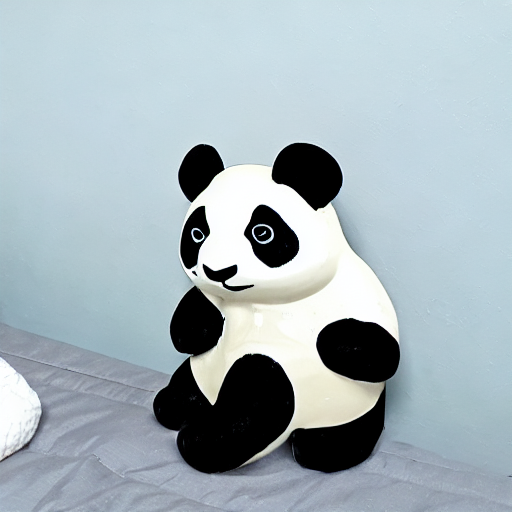

In [12]:
image = pipe(prompt, image=base_image, mask_image=mask_image, num_inference_steps=50, guidance_scale=7.5).images[0]
image

In [14]:
pipe.unet.load_attn_procs("./")

In [16]:
image=pipe("A picture of a sks panda sleeping", image=base_image, mask_image=mask_image, num_inference_steps=25).images[0]

  0%|          | 0/25 [00:00<?, ?it/s]

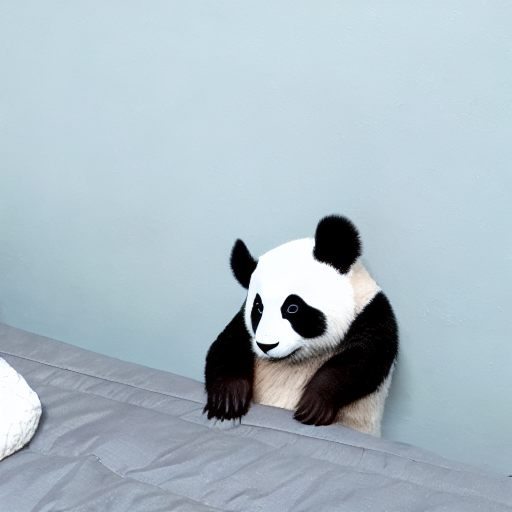

In [17]:
image

  0%|          | 0/25 [00:00<?, ?it/s]

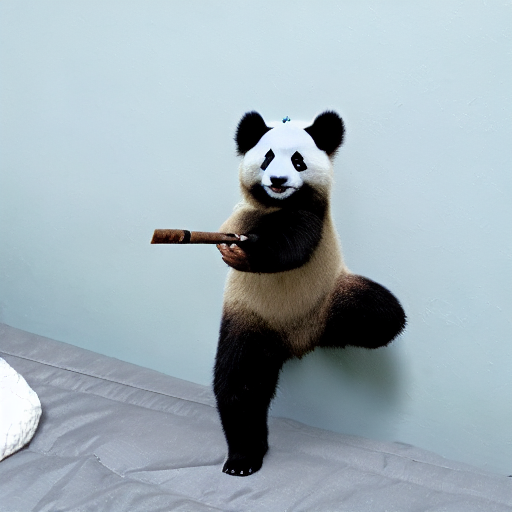

In [19]:
pipe.unet.load_attn_procs("./")
image=pipe("A picture of a sks panda dancing", image=base_image, mask_image=mask_image, num_inference_steps=25).images[0]
image

  0%|          | 0/25 [00:00<?, ?it/s]

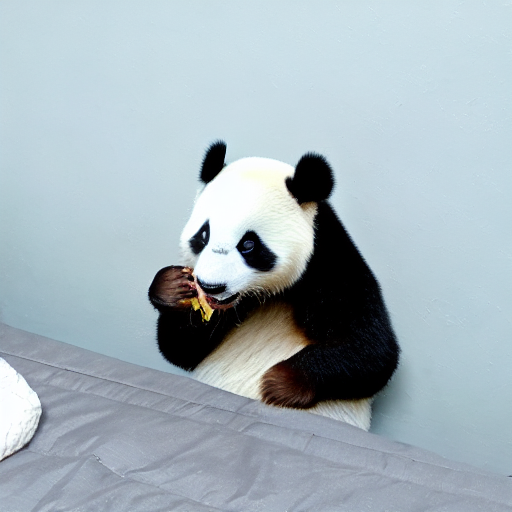

In [22]:
pipe.unet.load_attn_procs("./")
image=pipe("A picture of sks panda eating", image=base_image, mask_image=mask_image, num_inference_steps=25).images[0]
image

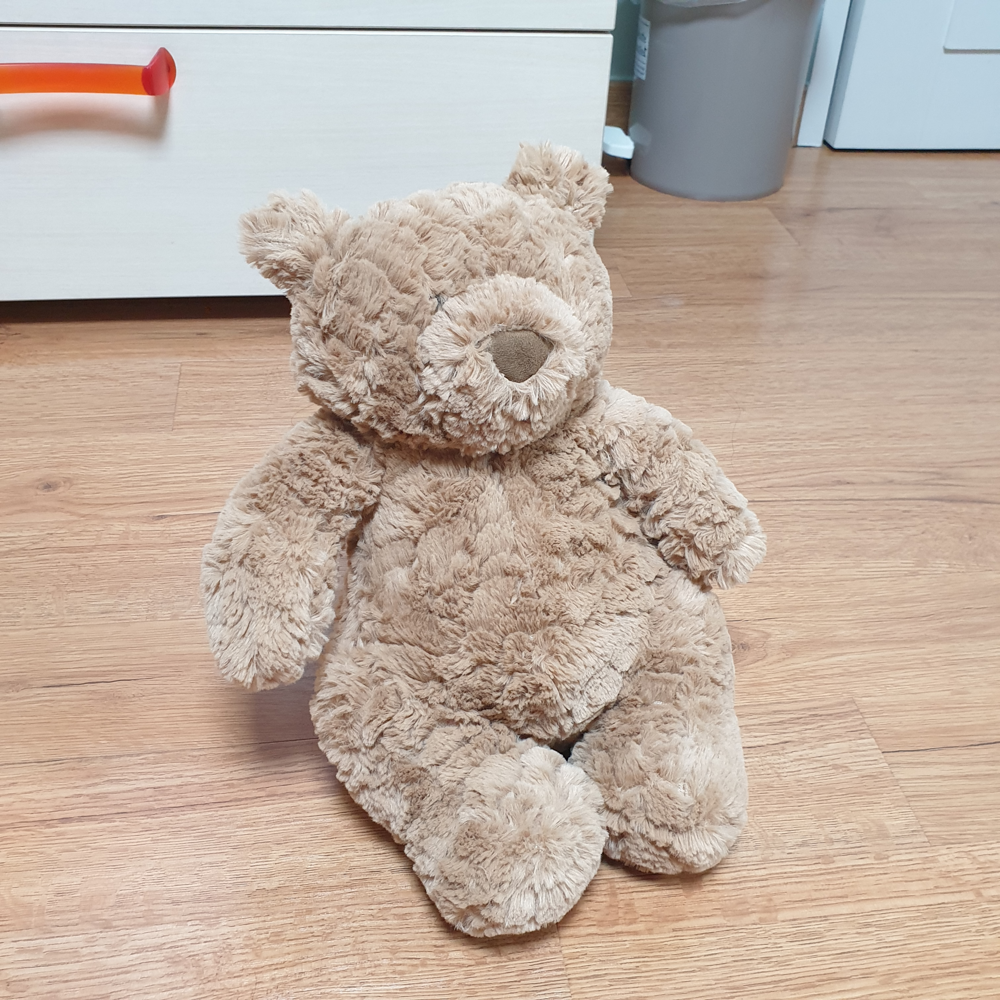

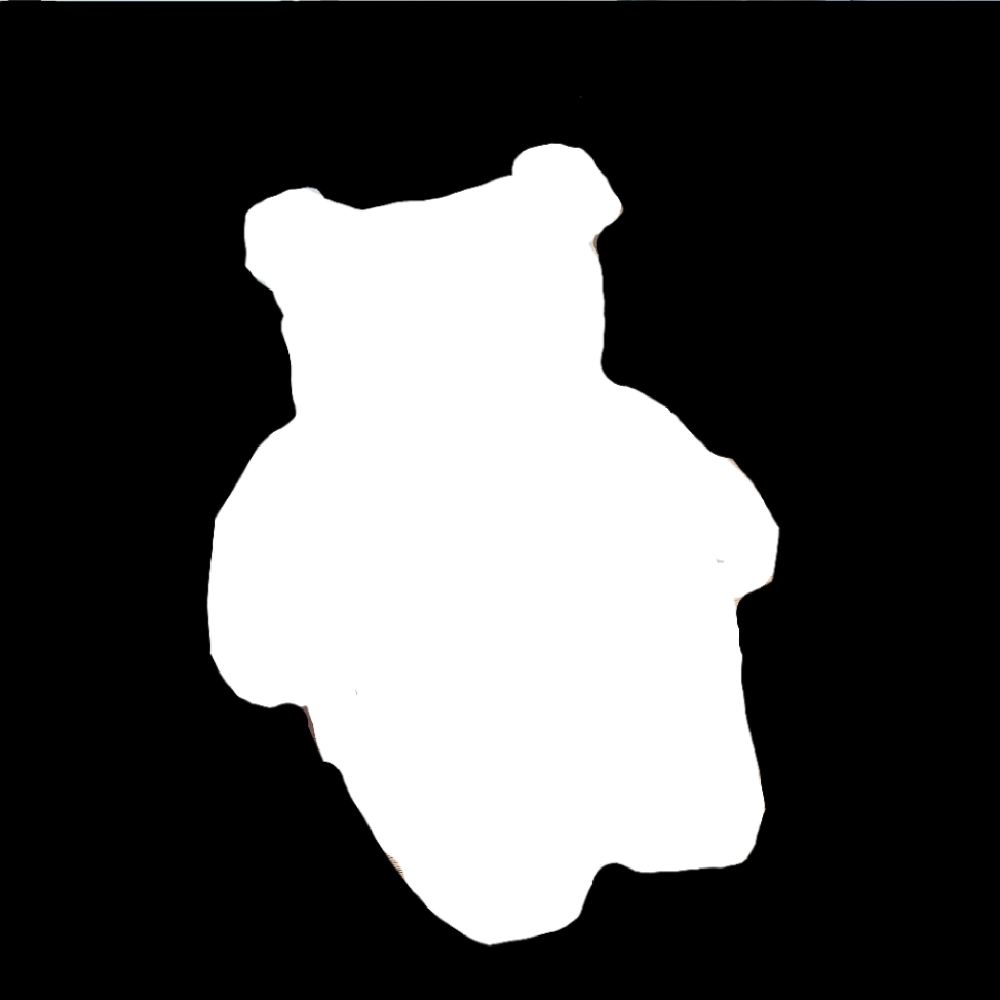

In [24]:
base_image2 = Image.open("test/base2.jpg").rotate(-90)
mask_image2 = Image.open("test/mask2.jpg")
base_image2.show()
mask_image2.show()

  0%|          | 0/25 [00:00<?, ?it/s]

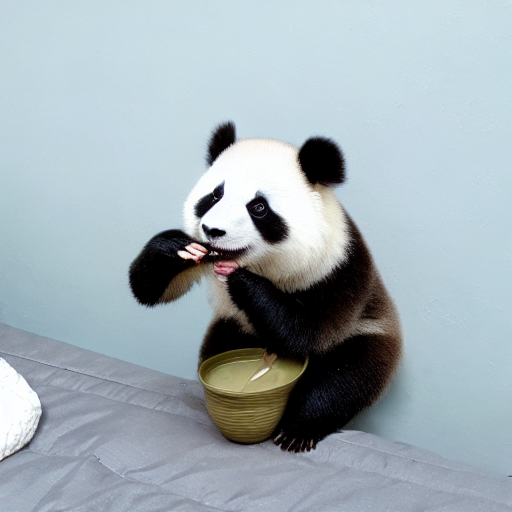

In [32]:
pipe.load_lora_weights("./")
image=pipe("A picture of a sks panda eating", image=base_image, mask_image=mask_image, num_inference_steps=25).images[0]
image